# 0.0. Imports

In [2]:
import pandas as pd
import numpy  as np
#import psycopg2 as pg
import pandas.io.sql as psql

import seaborn as sns
import scikitplot as skplt

from matplotlib import pyplot as plt

from sklearn import preprocessing as pp
from sklearn import model_selection as ms
from sklearn import ensemble as en
from sklearn import neighbors as nh
from sklearn import linear_model    as lm

from IPython.core.display  import HTML
from IPython.display       import Image

pd.options.mode.chained_assignment = None  # default='warn' 

## 0.1 Helper Functions

In [3]:
# section 1.2
def db_connection(db_host, db_port, db_database, db_user, db_password):
    conn = None
    try:
        conn = psycopg2.connect(
        host = db_host,
        port = db_port,
        database = db_database,
        user = db_user,
        password = db_password,
        )
        print('Conexão do banco de dados PostreSQL bem-sucedida!')
    except OperationalError as e:
        print('Erro {} ocorreu.'.format(e))
    return conn


def models_train(models,x_train,y_train,x_test,y_test,predict='predict',metric='regression',verbose=1):
    metrics=pd.DataFrame()
    for model in models:
        print(model.__class__.__name__)
        model.fit(x_train,y_train)
        if predict=='predict':
            yhat=model.predict(x_test)
        elif predict=='predict_proba':
            yhat=model.predict_proba(x_test)
            yhat=yhat[:, 1]
        
        if metric=='regression':
            metrics=metrics.append(regression_metrics(model.__class__.__name__,y_test,yhat,verbose))
        elif metric=='multiClass':
            metrics=metrics.append(multi_class_metrics(model.__class__.__name__,y_test,yhat,verbose))
        elif metric=='binaryClass':
            metrics=metrics.append(ranking_class_metrics(model.__class__.__name__,y_test,yhat,verbose))
            
    return metrics

def regression_metrics(model,y_val,yhat,verbose =1):
    
    model = pd.DataFrame([model]).T
    
    #Accuracy
    acc = m.accuracy_score(y_val,yhat)
    accdf = pd.DataFrame([acc]).T

    #Balanced Accuracy
    balanced= m.balanced_accuracy_score(y_val,yhat)
    balanceddf = pd.DataFrame([balanced]).T

    #Kappa Metrics
    kappa= m.cohen_kappa_score(y_val, yhat)
    kappadf = pd.DataFrame([kappa]).T
    
    metrics = pd.concat([model,accdf,balanceddf,kappadf]).T.reset_index()
    metrics.columns=['Index','Model','Accuracy','Balanced Accuracy','Kappa Score']
    metrics.drop(['Index'],axis=1)
    if verbose ==1:
        print('Accuracy: {}'.format(acc))
        print('Balanced Accuracy: {}'.format(balanced))
        print('Kappa Score: {}'.format(kappa))
        #Classification Report
        print(m.classification_report(y_val,yhat))
        # Confision Matrix
        mt.plot_confusion_matrix(y_val,yhat,normalize=False,figsize=(12,12))
        
    return metrics

def multi_class_metrics(model,y_val,yhat,verbose =1):
    
    model = pd.DataFrame([model]).T

    #Precision Score
    precision= m.precision_score(y_val, yhat)
    precisiondf = pd.DataFrame([precision]).T
    
    #Recall Score
    recall= m.recall_score(y_val, yhat)
    recalldf = pd.DataFrame([recall]).T
    
    #F1 Score
    f1= m.f1_score(y_val, yhat)
    f1df = pd.DataFrame([f1]).T
    
    #MAtthews Correlation
    mcc=m.matthews_corrcoef(y_val,yhat)
    mccdf=pd.DataFrame([mcc])    
    
    metrics = pd.concat([model,precisiondf,recalldf,f1df,mccdf]).T.reset_index()
    metrics.columns=['Index','Model','Precision Score','Recall Score','F1 Score','Matthew Correlation Score']
    metrics.drop(['Index'],axis=1)
    if verbose ==1:
        print('Precision Score: {}'.format(precision))
        print('Recall Score: {}'.format(recall))
        print('F1 Score: {}'.format(f1))
        print('Matthew Correlation Score: {}'.format(mcc))
        #Classification Report
        print(m.classification_report(y_val,yhat))
        # Confision Matrix
        mt.plot_confusion_matrix(y_val,yhat,normalize=False,figsize=(12,12))
        
    return metrics

def ranking_class_metrics(model,y_val,yhat,verbose =1):
    
    model = pd.DataFrame([model]).T

    #AUC_ROC
    roc=m.roc_auc_score(y_val,yhat)
    rocdf=pd.DataFrame([roc])
    
    #topk Score
    knum=y_val.value_counts().count()-1
    topk=m.top_k_accuracy_score(y_val,yhat,k=knum)
    topkdf=pd.DataFrame([topk])    
    
    metrics = pd.concat([model,rocdf,topkdf]).T.reset_index()
    metrics.columns=['Index','Model','ROC AUC','Top K Score']
    metrics.drop(['Index'],axis=1)
    if verbose ==1:
        print('ROC AUC: {}'.format(roc))
        print('Top K Score: {}'.format(topk))
        #Classification Report
        print(m.classification_report(y_val,yhat))
        # Confision Matrix
        mt.plot_confusion_matrix(y_val,yhat,normalize=False,figsize=(12,12))
        
    return metrics

def precision_at_k(df,yhat_proba,target,perc=0.25):
    k=int(np.floor(len(df)*perc))
    df['score']=yhat_proba[:,1].tolist()
    df=df.sort_values('score',ascending=False)
    df=df.reset_index(drop=True)
    df['ranking']=df.index+1
    df['precision_at_k']=df[target].cumsum()/df['ranking']
    return df.loc[k,'precision_at_k']    

def recall_at_k(df,yhat_proba,target,perc=0.25):
    k=int(np.floor(len(df)*perc))
    df['score']=yhat_proba[:,1].tolist()
    df=df.sort_values('score',ascending=False)
    df=df.reset_index(drop=True)
    df['recall_at_k']=df[target].cumsum()/df[target].sum()
    return df.loc[k,'recall_at_k'] 

def topK_performance(df,probas,response,perc):
    df_final_performance=pd.DataFrame()
    for i in probas:   
        for j in perc:
            k=int(np.floor(len(df_mp)*j))

            df_tg=df.copy()
            target_total=df_tg[response].sum()
            df_tg['score']= i[:,1].tolist()
            df_tg=df_tg.sort_values('score',ascending=False)
            target_at_k=df_tg[response][:k].sum()
            target_perc=target_at_k/target_total

            precision=precision_at_k(df,i,response,j)
            recall=recall_at_k(df,i,response,j)

            df_final_performance=df_final_performance.append({'Model':'Model','perc':j,'k':k,'precision':precision,'recall':recall,'target_total':target_total,'target_at_k':target_at_k,'perc_target':target_perc},ignore_index=True)
    return df_final_performance



# section 
def cramer_v( x, y ):
    cm = pd.crosstab( x, y ).as_matrix() #cm confusion metrics  crosstab (Calcule uma tabulação cruzada simples de dois (ou mais) fatores)
    n = cm.sum()
    r, k = cm.shape  #número de linhas e colunas
    
    chi2 = ss.chi2_contingency( cm )[0]  #chi2 já tem método para calcular com scipy
    chi2corr = max( 0, chi2 - (k-1)*(r-1)/(n-1) )
    
    kcorr = k - (k-1)**2/(n-1)
    rcorr = r - (r-1)**2/(n-1)
    
    return np.sqrt( (chi2corr/n) / ( min( kcorr-1, rcorr-1 ) ) )


def jupyter_settings():
    
    %matplotlib inline 
    #%pylab inline
    
    plt.style.use('bmh')
    plt.rcParams['figure.figsize']=[20,10]
    plt.rcParams['font.size']=10
    
    display( HTML('<style>.container {width:100% !important; }</style>'))
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option('display.expand_frame_repr',False )
    
    sns.set()
    
# ignore warnings
import warnings
warnings.filterwarnings("ignore")

In [4]:
def precision_at_k(df,yhat_proba,target,perc=0.25):
    k=int(np.floor(len(df)*perc))
    df['score']=yhat_proba[:,1].tolist()
    df=df.sort_values('score',ascending=False)
    df=df.reset_index(drop=True)
    df['ranking']=df.index+1
    df['precision_at_k']=df[target].cumsum()/df['ranking']
    return df.loc[k,'precision_at_k']

In [5]:
jupyter_settings() 

## 0.1. Connection with Database

- O módulo psycopg2 permite estabelecer conexão e consultar um banco de dados PostgreSQL e está disponível como um pacote indicador do Linux, macOS ou WindowsO 
- fetchall () busca todas as linhas no conjunto de resultados e retorna uma lista de tuplas. Se não houver linhas para buscar, o método fetchall () retorna uma lista vazia.

### 1.1 Schema Query

In [98]:
#Credential from SQL
host = 'comunidade-ds-postgres.c50pcakiuwi3.us-east-1.rds.amazonaws.com'
port = 5432
database = 'comunidadedsdb'
username = 'member'
pwd = 'cdspa'

### 1.2 Connection with Database


In [99]:
#Connecting SQL
conn = pg.connect (
                user = username,
                password = pwd,
                host = host,
                port = port,
                database = database)



### 1.3 Exploration Database

In [86]:
#Getting tables name from database
query = "SELECT * FROM information_schema.tables WHERE table_type = 'BASE TABLE' AND table_schema = 'pa004';"

pd.read_sql_query(query,conn)

/var/folders/55/kp2841xx6lgfq642dzt475640000gn/T/ipykernel_20576/2199212706.py:4: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  pd.read_sql_query(query,conn)


,table_catalog,table_schema,table_name,table_type,self_referencing_column_name,reference_generation,user_defined_type_catalog,user_defined_type_schema,user_defined_type_name,is_insertable_into,is_typed,commit_action
0,comunidadedsdb,pa004,users,BASE TABLE,None,None,None,None,None,YES,NO,None
1,comunidadedsdb,pa004,vehicle,BASE TABLE,None,None,None,None,None,YES,NO,None
2,comunidadedsdb,pa004,insurance,BASE TABLE,None,None,None,None,None,YES,NO,None


In [87]:
#Exploring database

query = """
            SELECT table_schema, table_name FROM information_schema.tables
            WHERE table_type= 'BASE TABLE' AND table_schema='pa004' 
"""

pd.read_sql_query(query,conn)

/var/folders/55/kp2841xx6lgfq642dzt475640000gn/T/ipykernel_20576/1733474152.py:8: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  pd.read_sql_query(query,conn)


,table_schema,table_name
0,pa004,users
1,pa004,vehicle
2,pa004,insurance


In [88]:
#Table Information Users
query = """
            SELECT column_name, data_type FROM information_schema.columns
            WHERE table_name= 'users' 
"""
pd.read_sql_query(query,conn)

/var/folders/55/kp2841xx6lgfq642dzt475640000gn/T/ipykernel_20576/853695384.py:6: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  pd.read_sql_query(query,conn)


,column_name,data_type
0,id,integer
1,gender,text
2,age,integer
3,region_code,double precision
4,policy_sales_channel,double precision


In [89]:
#Table Information vehicle
query = """
            SELECT column_name, data_type FROM information_schema.columns
            WHERE table_name= 'vehicle' 
"""
pd.read_sql_query(query,conn)

/var/folders/55/kp2841xx6lgfq642dzt475640000gn/T/ipykernel_20576/1863313423.py:6: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  pd.read_sql_query(query,conn)


,column_name,data_type
0,id,integer
1,driving_license,integer
2,vehicle_age,text
3,vehicle_damage,text


In [90]:
#Table Information insurance
query = """
            SELECT column_name, data_type FROM information_schema.columns
            WHERE table_name= 'insurance' 
"""
pd.read_sql_query(query,conn)

/var/folders/55/kp2841xx6lgfq642dzt475640000gn/T/ipykernel_20576/1968748016.py:6: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  pd.read_sql_query(query,conn)


,column_name,data_type
0,id,integer
1,previously_insured,integer
2,annual_premium,double precision
3,vintage,integer
4,response,integer


### 1.4 Collect Data using PANDAS

In [100]:
query_table_users = """
    SELECT u.id,
         u.gender,
         u.age,
         u.region_code,
         u.policy_sales_channel,
         v.driving_license,
         v.vehicle_age,
         v.vehicle_damage,
         i.previously_insured,
         i.annual_premium,
         i.vintage,
         i.response
  FROM pa004.users u 
  LEFT JOIN pa004.vehicle v ON (u.id = v.id)
  LEFT JOIN pa004.insurance i ON (u.id = i.id)
"""

df = psql.read_sql ( query_table_users, conn )
df.head()


/var/folders/55/kp2841xx6lgfq642dzt475640000gn/T/ipykernel_20576/2704541247.py:19: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = psql.read_sql ( query_table_users, conn )


,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response
0,7,Male,23,11.0,152.0,1,< 1 Year,Yes,0,23367.0,249,0
1,13,Female,41,15.0,14.0,1,1-2 Year,No,1,31409.0,221,0
2,18,Female,25,35.0,152.0,1,< 1 Year,No,1,46622.0,299,0
3,31,Female,26,8.0,160.0,1,< 1 Year,No,0,2630.0,136,0
4,39,Male,45,8.0,124.0,1,1-2 Year,Yes,0,42297.0,264,0


In [102]:
df_raw = df.copy()

# 1.0. Data Description

In [116]:
df_raw = pd.read_csv( '../data/raw/train.csv', encoding='utf-8' )

In [117]:
df1 = df_raw.copy()

In [118]:
 cols_new = ['id', 'gender', 'age', 'driving_license', 'region_code', 'previously_insured', 
            'vehicle_age', 'vehicle_damage', 'annual_premium', 'policy_sales_channel', 'vintage', 'response']
            
df1.columns = cols_new  

In [119]:
df1.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage,response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0


## 1.1. Data Dimension

In [120]:
print( 'Number of Rows: {}'.format( df1.shape[0] ) )
print( 'Number of Columns: {}'.format( df1.shape[1] ) )

Number of Rows: 381109
Number of Columns: 12


## 1.2. Data Types

In [121]:
df1.dtypes

id                        int64
gender                   object
age                       int64
driving_license           int64
region_code             float64
previously_insured        int64
vehicle_age              object
vehicle_damage           object
annual_premium          float64
policy_sales_channel    float64
vintage                   int64
response                  int64
dtype: object

## 1.3. Check NA

In [122]:
df1.isna().sum()

id                      0
gender                  0
age                     0
driving_license         0
region_code             0
previously_insured      0
vehicle_age             0
vehicle_damage          0
annual_premium          0
policy_sales_channel    0
vintage                 0
response                0
dtype: int64

## 1.4. Data Descriptive

In [123]:
num_attributes = df1.select_dtypes( include=['int64', 'float64'] )
cat_attributes = df1.select_dtypes( exclude=['int64', 'float64', 'datetime64[ns]'])

In [124]:
# Central Tendency - Mean, Median
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# dispersion - std, min, max, range, skew, kurtosis
d1 = pd.DataFrame( num_attributes.apply( np.std ) ).T 
d2 = pd.DataFrame( num_attributes.apply( min ) ).T 
d3 = pd.DataFrame( num_attributes.apply( max ) ).T 
d4 = pd.DataFrame( num_attributes.apply( lambda x: x.max() - x.min() ) ).T 
d5 = pd.DataFrame( num_attributes.apply( lambda x: x.skew() ) ).T 
d6 = pd.DataFrame( num_attributes.apply( lambda x: x.kurtosis() ) ).T 

# concatenar
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()
m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,id,1.0,381109.0,381108.0,190555.000000,190555.0,110016.691870,9.443274e-16,-1.200000
1,age,20.0,85.0,65.0,38.822584,36.0,15.511591,6.725390e-01,-0.565655
2,driving_license,0.0,1.0,1.0,0.997869,1.0,0.046109,-2.159518e+01,464.354302
3,region_code,0.0,52.0,52.0,26.388807,28.0,13.229871,-1.152664e-01,-0.867857
4,previously_insured,0.0,1.0,1.0,0.458210,0.0,0.498251,1.677471e-01,-1.971871
5,annual_premium,2630.0,540165.0,537535.0,30564.389581,31669.0,17213.132474,1.766087e+00,34.004569
6,policy_sales_channel,1.0,163.0,162.0,112.034295,133.0,54.203924,-9.000081e-01,-0.970810
7,vintage,10.0,299.0,289.0,154.347397,154.0,83.671194,3.029517e-03,-1.200688
8,response,0.0,1.0,1.0,0.122563,0.0,0.327935,2.301906e+00,3.298788


# 2.0. Feature Engineering

In [125]:
df2 =  df1.copy()

In [126]:
# vehicle damage
df2['vehicle_damage'] =  df2['vehicle_damage'].apply( lambda x: 1 if x == 'Yes' else 0 )

In [127]:
df2.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage,response
0,1,Male,44,1,28.0,0,> 2 Years,1,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,0,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,1,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,0,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,0,27496.0,152.0,39,0


# 3.0. Data Filtering

In [128]:
df3 = df2.copy()

# 4.0. EDA

In [129]:
df4 = df3.copy()

## 4.1. Univariate Analysis

<AxesSubplot: xlabel='response', ylabel='age'>

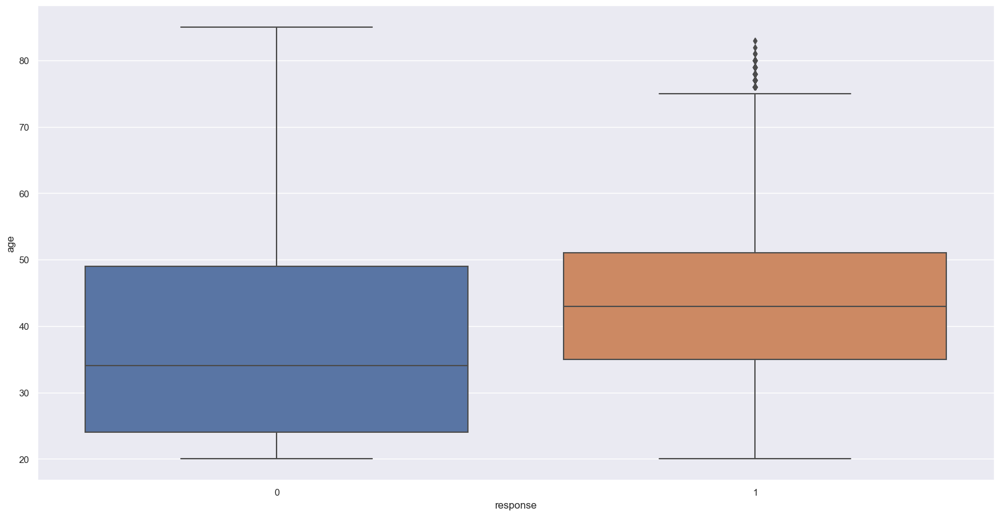

In [130]:
#'age'
sns.boxplot( x='response', y='age', data=df4 )

<AxesSubplot: xlabel='age', ylabel='Count'>

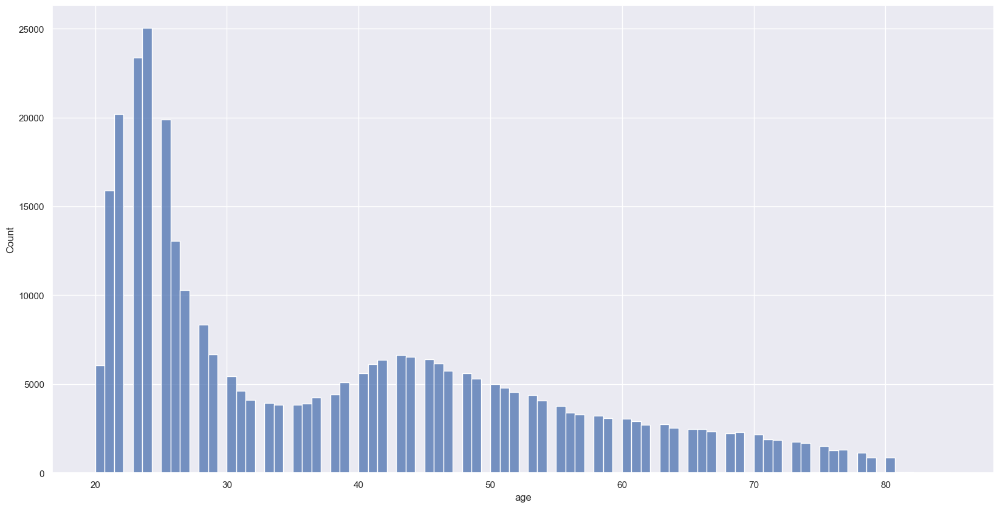

In [101]:
aux00 = df4.loc[df4['response'] == 0, 'age']
sns.histplot( aux00 )

<AxesSubplot: xlabel='age', ylabel='Count'>

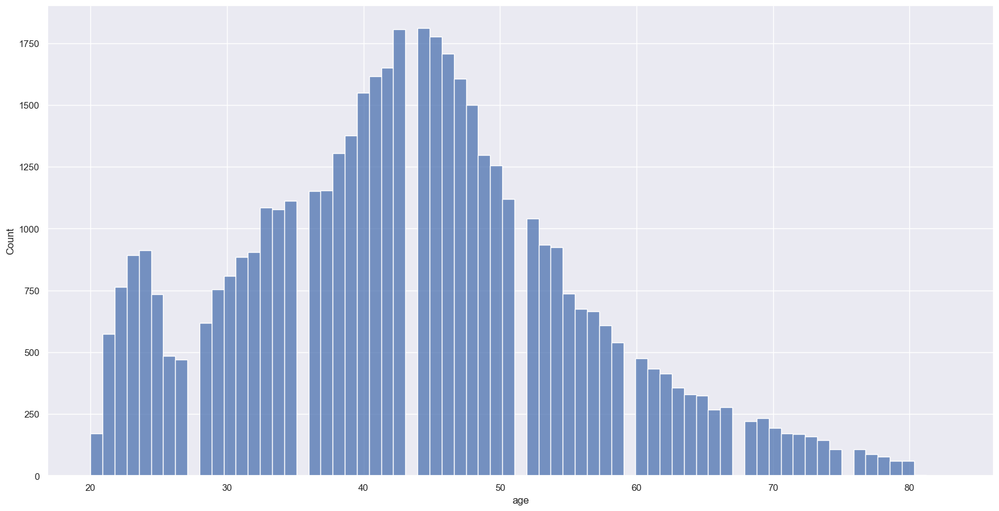

In [102]:
aux00 = df4.loc[df4['response'] == 1, 'age']
sns.histplot( aux00 )

<AxesSubplot: xlabel='response', ylabel='annual_premium'>

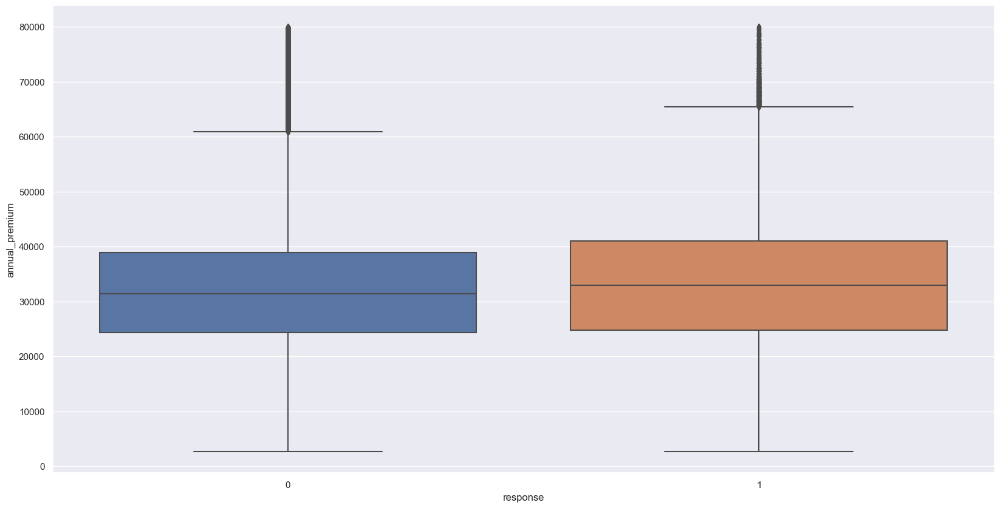

In [103]:
#'annual_premium'
aux = df4[df4['annual_premium'] < 80000] #There are a lot of Outliers
sns.boxplot( x='response', y='annual_premium', data=aux )

<AxesSubplot: xlabel='annual_premium', ylabel='Count'>

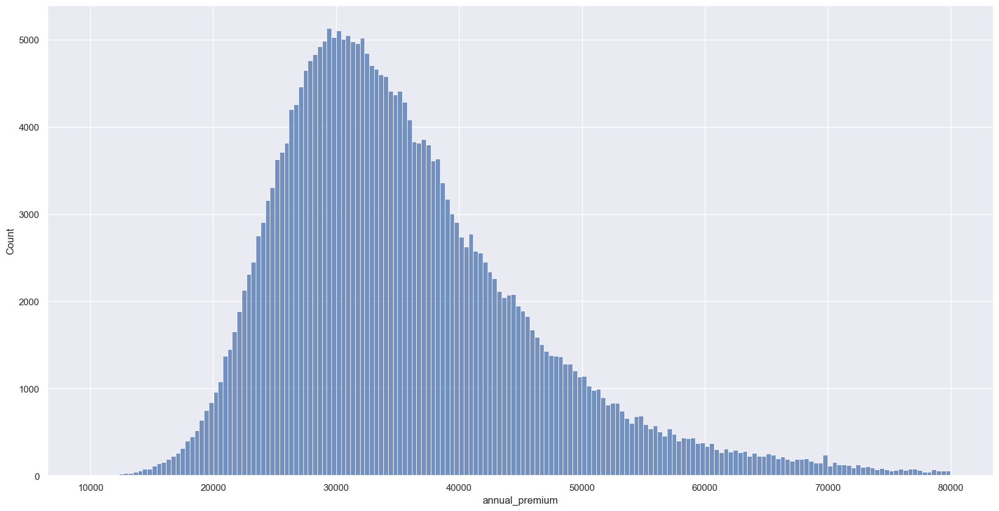

In [104]:
aux = df4[(df4['annual_premium'] > 10000) &(df4['annual_premium'] < 80000 )]
aux00 = aux.loc[aux['response'] == 0, 'annual_premium']
sns.histplot( aux00 )

<AxesSubplot: xlabel='annual_premium', ylabel='Count'>

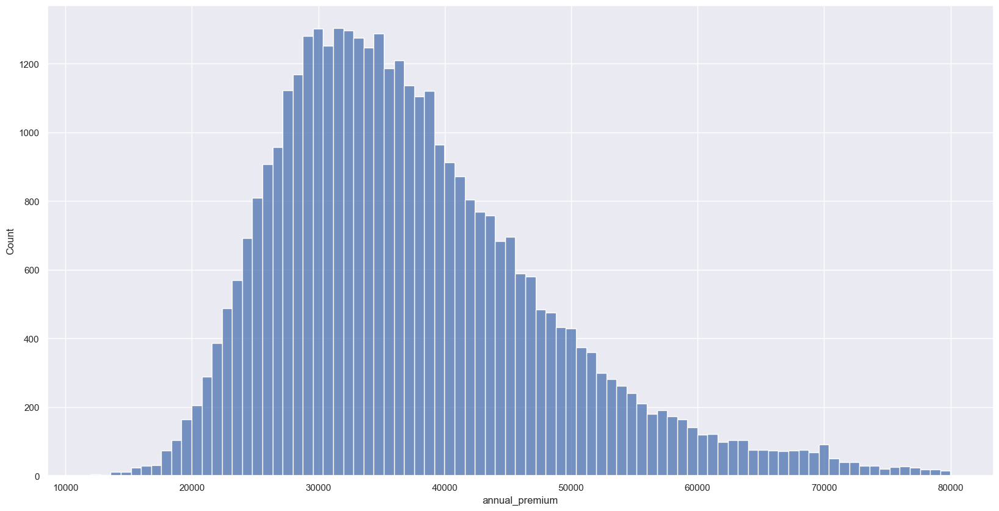

In [105]:
aux00 = aux.loc[aux['response'] == 1, 'annual_premium']
sns.histplot( aux00 )

<AxesSubplot: xlabel='response', ylabel='driving_license'>

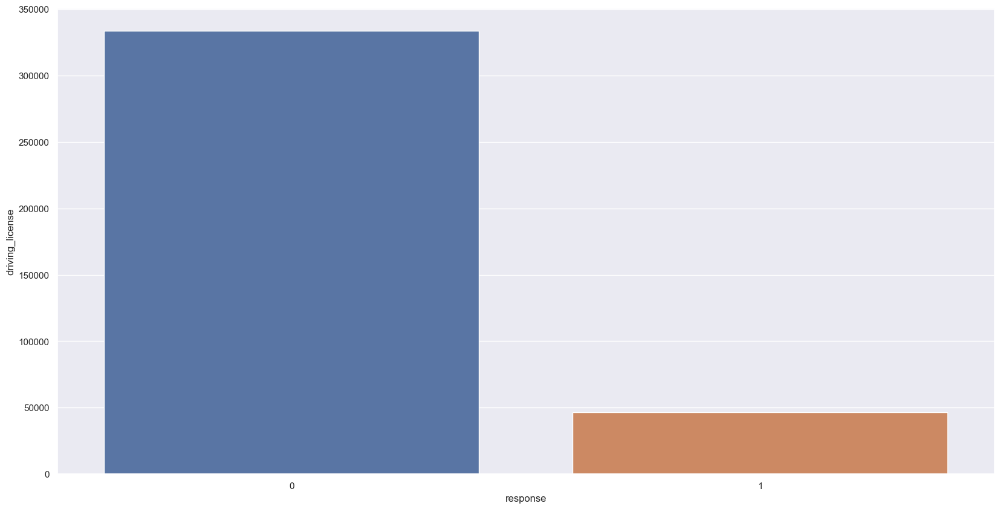

In [106]:
#'driving_license'
aux = df4[['driving_license', 'response']].groupby( 'response' ).sum().reset_index()
aux.head()
aux['driving_license_perc'] = aux['driving_license'] / aux['driving_license'].sum()
sns.barplot( x='response', y='driving_license', data=aux )

<AxesSubplot: xlabel='region_code', ylabel='id'>

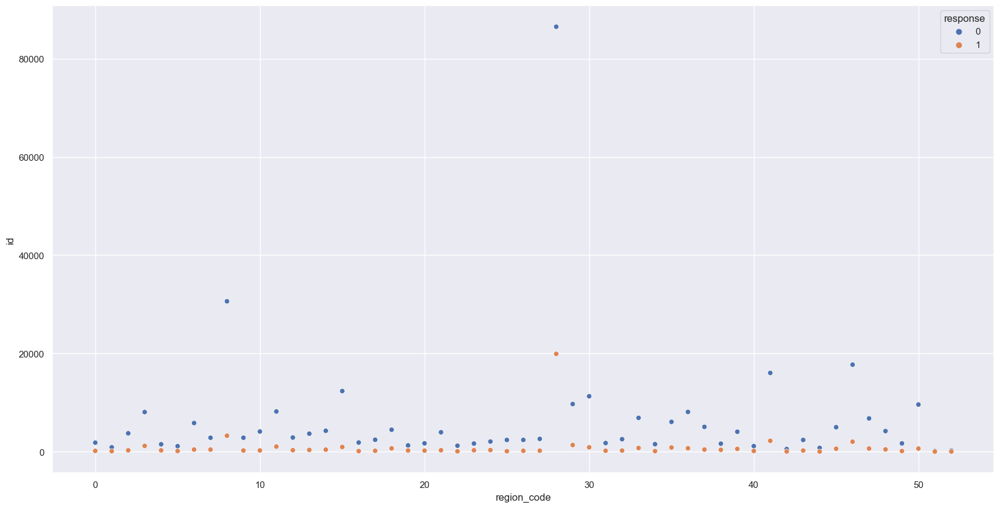

In [107]:
# 'region_code'
aux0 = df4[['id', 'region_code', 'response']].groupby( ['region_code', 'response'] ).count().reset_index()

sns.scatterplot( x='region_code', y='id', hue='response', data=aux0)

In [108]:
#'gender'
df4[['gender', 'response']].value_counts( normalize=True ).reset_index()

,gender,response,0
0,Male,0,0.465914
1,Female,0,0.411523
2,Male,1,0.074847
3,Female,1,0.047716


In [109]:
#'previously_insured'
pd.crosstab( df4['previously_insured'], df4['response'] ).apply( lambda x: x / x.sum(), axis=1 )

response,0,1
previously_insured,,
0,0.774546,0.225454
1,0.999095,0.000905


In [110]:
#'vehicle_age'
df4[['vehicle_age', 'response']].value_counts( normalize=True ).reset_index()

,vehicle_age,response,0
0,1-2 Year,0,0.434285
1,< 1 Year,0,0.413488
2,1-2 Year,1,0.091328
3,> 2 Years,0,0.029663
4,< 1 Year,1,0.018897
5,> 2 Years,1,0.012338


<AxesSubplot: xlabel='response', ylabel='policy_sales_channel'>

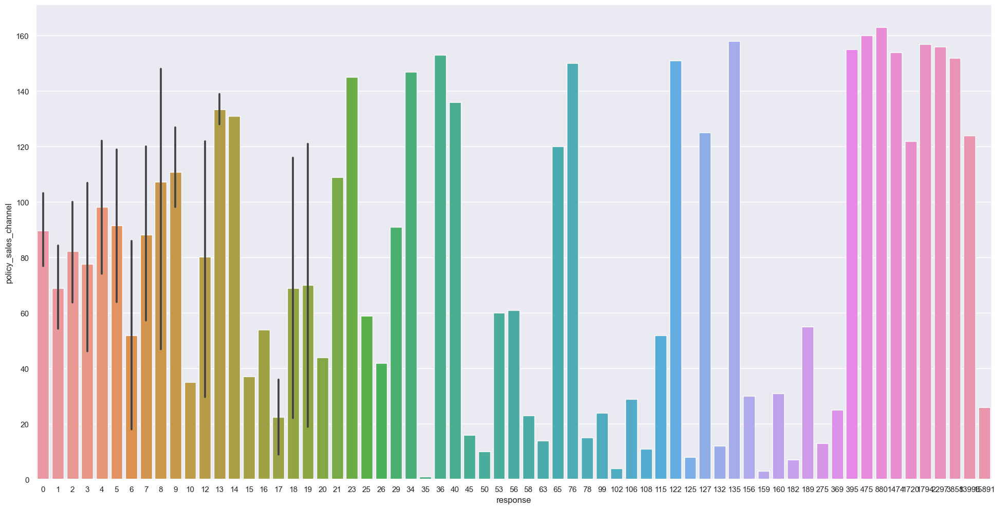

In [111]:
#'policy_sales_channel'
plt.figure( figsize=(24, 12 ))
aux = df4[['policy_sales_channel', 'response']].groupby( 'policy_sales_channel').sum().reset_index()
sns.barplot( x='response', y='policy_sales_channel', data=aux )

<AxesSubplot: xlabel='response', ylabel='vintage'>

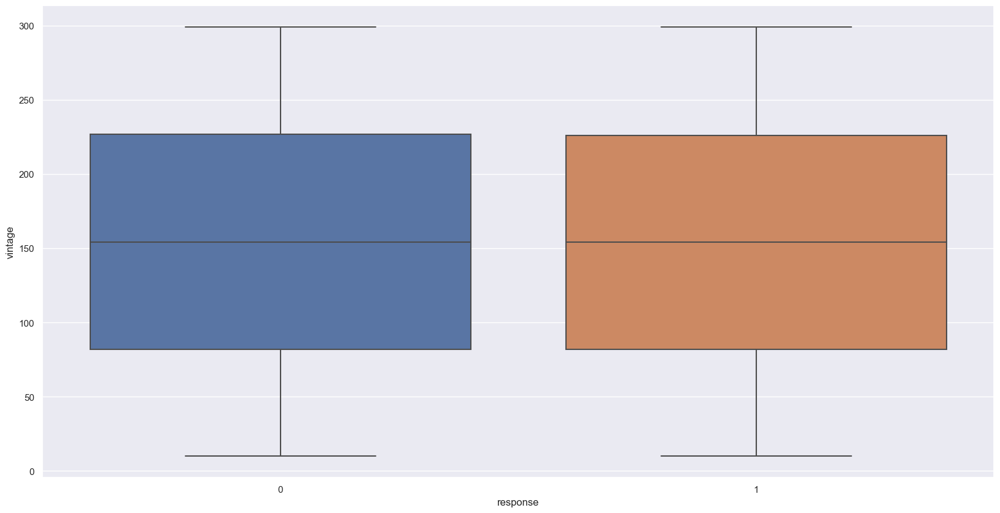

In [112]:
#'vintage'
sns.boxplot( x='response', y='vintage', data=df4 )

<AxesSubplot: xlabel='vintage', ylabel='Count'>

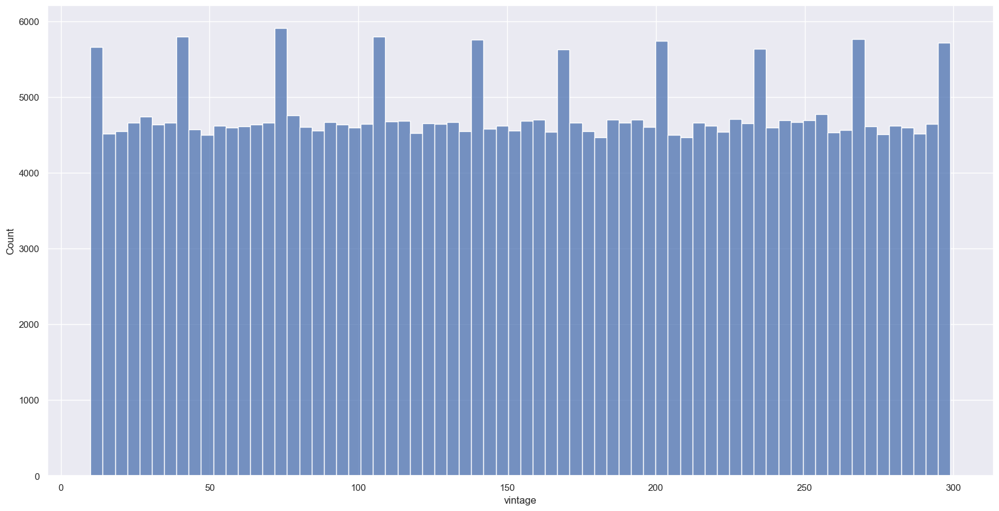

In [113]:
aux00 = df4.loc[df4['response'] == 0, 'vintage']
sns.histplot( aux00 )

<AxesSubplot: xlabel='vintage', ylabel='Count'>

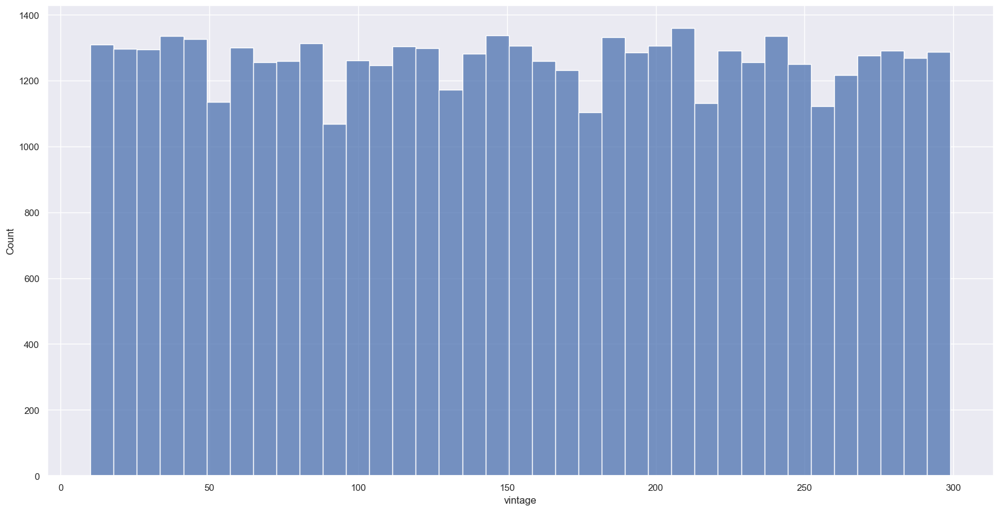

In [114]:
aux00 = df4.loc[df4['response'] == 1, 'vintage']
sns.histplot( aux00 )

# 5.0. Data Preparation

In [213]:
df5 = df4.copy()

In [214]:
df4.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage,response
0,1,Male,44,1,28.0000,0,> 2 Years,1,40454.0000,26.0000,217,1
1,2,Male,76,1,3.0000,0,1-2 Year,0,33536.0000,26.0000,183,0
2,3,Male,47,1,28.0000,0,> 2 Years,1,38294.0000,26.0000,27,1
3,4,Male,21,1,11.0000,1,< 1 Year,0,28619.0000,152.0000,203,0
4,5,Female,29,1,41.0000,1,< 1 Year,0,27496.0000,152.0000,39,0


In [215]:
#Slipt Dataset for Test and Traninng 

X = df4.drop( 'response', axis=1 )
y = df4['response'].copy() 

x_train, x_validation, y_train, y_validation = ms.train_test_split( X, y, test_size=0.20 )

df5 = pd.concat( [x_train, y_train], axis=1 )

In [147]:
x_validation.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage
221875,221876,Male,52,1,28.0,0,1-2 Year,1,2630.0,158.0,187
181636,181637,Female,25,1,47.0,1,< 1 Year,0,38073.0,152.0,39
49986,49987,Male,27,1,5.0,0,< 1 Year,1,29614.0,152.0,92
380776,380777,Female,42,1,41.0,0,1-2 Year,1,25481.0,124.0,80
300127,300128,Female,26,1,2.0,1,< 1 Year,0,31353.0,152.0,239


## Standardization

In [198]:
ss = pp.StandardScaler()

# annual_premium
df5['annual_premium'] = ss.fit_transform( df5[['annual_premium']].values )
pickle.dump( ss, open( '../src/features/annual_premium_scaler.pkl', 'wb' ) )


## Rescaling

In [199]:
mms_age = pp.MinMaxScaler()
mms_vintage = pp.MinMaxScaler()

# Age
df5['age'] = mms_age.fit_transform( df5[['age']].values )
pickle.dump( mms_age, open( '../src/features/mms_age.pkl', 'wb' ) )


# vintage
df5['vintage'] = mms_vintage.fit_transform( df5[['vintage']].values )
pickle.dump( mms_vintage, open( '../src/features/mms_vintage.pkl', 'wb' ) )


## Encoder

In [201]:
# gender - *One Hot Encoding* / Target Encoding
target_encode_gender = df5.groupby( 'gender' )['response'].mean()
df5.loc[:, 'gender'] = df5['gender'].map( target_encode_gender )
pickle.dump( target_encode_gender, open( '../src/features/target_encode_gender.pkl', 'wb' ) )


# region_code - Target Encoding / Frequency Encoding
target_encode_region_code = df5.groupby( 'region_code' )['response'].mean()
df5.loc[:, 'region_code'] = df5['region_code'].map( target_encode_region_code )
pickle.dump( target_encode_region_code, open( '../src/features/target_encode_region_code.pkl', 'wb' ) )

# vehicle_age - One Hot Encoding / Frequency Encoding
#df5 = pd.get_dummies( df5, prefix='vehicle_age', columns=['vehicle_age'] )
#df5 = pd.get_dummies( df5, prefix='driving_license', columns=['driving_license'] )
#df5 = pd.get_dummies( df5, prefix='previously_insured', columns=['previously_insured'] )
#df5 = pd.get_dummies( df5, prefix='vehicle_damage', columns=['vehicle_damage'] )


# policy_sales_channel - Target Encoding / *Frequency Encoding*
fe_policy_sales_channel = df5.groupby( 'policy_sales_channel' ).size() / len( df5 ) 
df5.loc[:, 'policy_sales_channel'] = df5['policy_sales_channel'].map( fe_policy_sales_channel )
pickle.dump( fe_policy_sales_channel, open( '../src/features/fe_policy_sales_channel.pkl', 'wb' ) )


In [151]:
df5.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_damage,annual_premium,policy_sales_channel,vintage,response,vehicle_age_1-2 Year,vehicle_age_< 1 Year,vehicle_age_> 2 Years
95145,95146,0.138267,0.046154,1,0.086362,1,0,-0.334630,0.353665,0.394464,0,0,1,0
128293,128294,0.104107,0.507692,1,0.186676,0,1,1.077876,0.208818,0.581315,0,1,0,0
169167,169168,0.104107,0.769231,1,0.080762,1,0,0.694096,0.000872,0.318339,0,1,0,0
329266,329267,0.104107,0.046154,1,0.123024,1,0,0.333582,0.353665,0.581315,0,0,1,0
309472,309473,0.104107,0.492308,1,0.095544,0,1,0.746271,0.208818,0.750865,1,1,0,0


## 5.4. Validation Preparation

In [152]:
# gender
x_validation.loc[:, 'gender'] =  x_validation.loc[:, 'gender'].map( target_encode_gender )

# age
x_validation.loc[:, 'age'] = mms_age.transform( x_validation[['age']].values )

# region_code
x_validation.loc[:, 'region_code'] = x_validation.loc[:, 'region_code'].map( target_encode_region_code )

# vehicle_age
x_validation = pd.get_dummies( x_validation, prefix='vehicle_age', columns=['vehicle_age'] )
#x_validation = pd.get_dummies( x_validation, prefix='driving_license', columns=['driving_license'] )
#x_validation = pd.get_dummies( x_validation, prefix='previously_insured', columns=['previously_insured'] )
#x_validation = pd.get_dummies( x_validation, prefix='vehicle_damage', columns=['vehicle_damage'] )


# annual_premium
x_validation.loc[:, 'annual_premium'] = ss.transform( x_validation[['annual_premium']].values )

# policy_sales_channel
x_validation.loc[:, 'policy_sales_channel'] = x_validation['policy_sales_channel'].map( fe_policy_sales_channel )

# vintage
x_validation.loc[:, 'vintage'] = mms_vintage.transform( x_validation[['vintage']].values )

# fillna
x_validation = x_validation.fillna( 0 )

In [153]:
df5.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_damage,annual_premium,policy_sales_channel,vintage,response,vehicle_age_1-2 Year,vehicle_age_< 1 Year,vehicle_age_> 2 Years
95145,95146,0.138267,0.046154,1,0.086362,1,0,-0.334630,0.353665,0.394464,0,0,1,0
128293,128294,0.104107,0.507692,1,0.186676,0,1,1.077876,0.208818,0.581315,0,1,0,0
169167,169168,0.104107,0.769231,1,0.080762,1,0,0.694096,0.000872,0.318339,0,1,0,0
329266,329267,0.104107,0.046154,1,0.123024,1,0,0.333582,0.353665,0.581315,0,0,1,0
309472,309473,0.104107,0.492308,1,0.095544,0,1,0.746271,0.208818,0.750865,1,1,0,0


# 6.0. Feature Selection

## 6.1. Features Importancia

In [111]:
# model definition
forest = en.ExtraTreesClassifier( n_estimators=250, random_state=0, n_jobs=-1 )

# data preparation
x_train_n = df5.drop( ['id', 'response'], axis=1 )
y_train_n = y_train.values
forest.fit( x_train_n, y_train_n )

ExtraTreesClassifier(n_estimators=250, n_jobs=-1, random_state=0)

Feature ranking:
                 feature  importance
0                vintage    0.274818
0         annual_premium    0.245309
0                    age    0.163758
0            region_code    0.105331
0         vehicle_damage    0.070605
0   policy_sales_channel    0.058888
0     previously_insured    0.053857
0   vehicle_age_< 1 Year    0.014181
0   vehicle_age_1-2 Year    0.006273
0                 gender    0.004423
0  vehicle_age_> 2 Years    0.002070
0        driving_license    0.000485


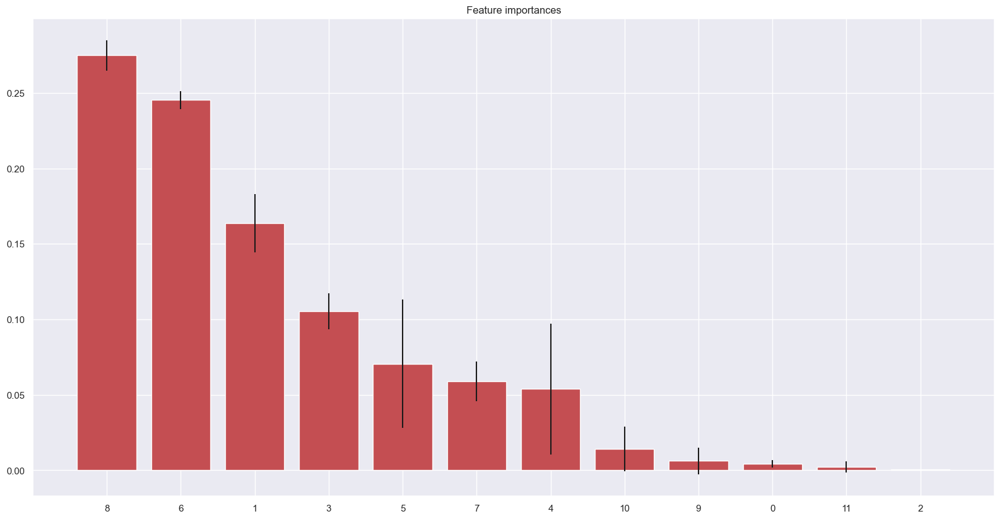

In [112]:
importances = forest.feature_importances_
std = np.std([tree.feature_importances_ for tree in forest.estimators_], axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")
df = pd.DataFrame()
for i, j in zip( x_train_n, forest.feature_importances_ ):
    aux = pd.DataFrame( {'feature': i, 'importance': j}, index=[0] )
    df = pd.concat( [df, aux], axis=0 )
    
print( df.sort_values( 'importance', ascending=False ) )

# Plot the impurity-based feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(x_train_n.shape[1]), importances[indices], color="r", yerr=std[indices], align="center")
plt.xticks(range(x_train_n.shape[1]), indices)
plt.xlim([-1, x_train_n.shape[1]])
plt.show()

In [113]:
from sklearn.ensemble     import RandomForestRegressor
from sklearn.ensemble     import RandomForestClassifier

## Recursive Feature Elimination

Feature: 0, Score: 0.02667
Feature: 1, Score: 0.13637
Feature: 2, Score: 0.00051
Feature: 3, Score: 0.09339
Feature: 4, Score: 0.01235
Feature: 5, Score: 0.12524
Feature: 6, Score: 0.26201
Feature: 7, Score: 0.05859
Feature: 8, Score: 0.27088
Feature: 9, Score: 0.00729
Feature: 10, Score: 0.00283
Feature: 11, Score: 0.00387


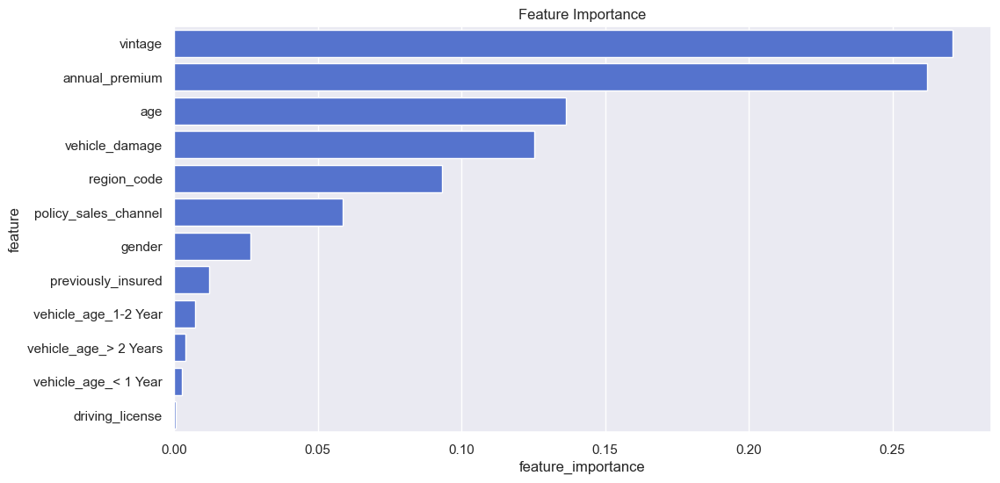

In [91]:
rf = RandomForestRegressor()
# fit the model
rf.fit(x_train_n, y_train_n)
# get importance
importance = rf.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
feat_imp = pd.DataFrame({'feature': x_train_n.columns,
                        'feature_importance': importance})\
                        .sort_values('feature_importance', ascending=False)\
                        .reset_index(drop=True)
plt.subplots(figsize=(12,6))
sns.barplot(x='feature_importance', y='feature', data=feat_imp, orient='h', color='royalblue')\
    .set_title('Feature Importance');

# 7.0. Machine Learning

In [155]:
cols_selected = ['annual_premium', 'vintage', 'age', 'region_code', 'policy_sales_channel','vehicle_damage']

x_train = df5[ cols_selected ]
x_val = x_validation[ cols_selected ]
y_val = y_validation.copy()

## 7.1. KNN

In [156]:
#poder de gereralizacao do modelo

# model definition
knn_model = nh.KNeighborsClassifier( n_neighbors=7 )

# model training
knn_model.fit( x_train, y_train )

# model prediction - Poder de GENERALIZACAO 
yhat_knn = knn_model.predict_proba( x_val )

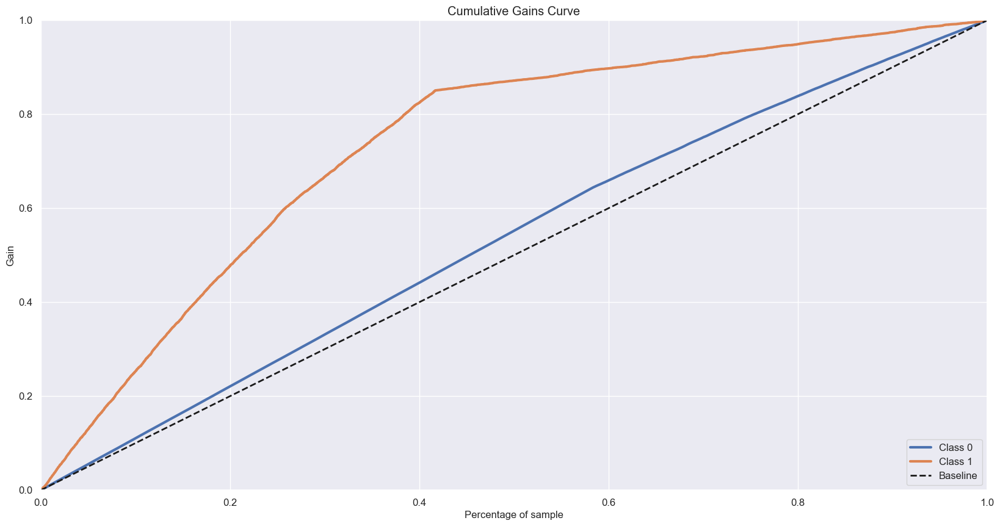

In [157]:
# Accumulative Gain
skplt.metrics.plot_cumulative_gain( y_val, yhat_knn );

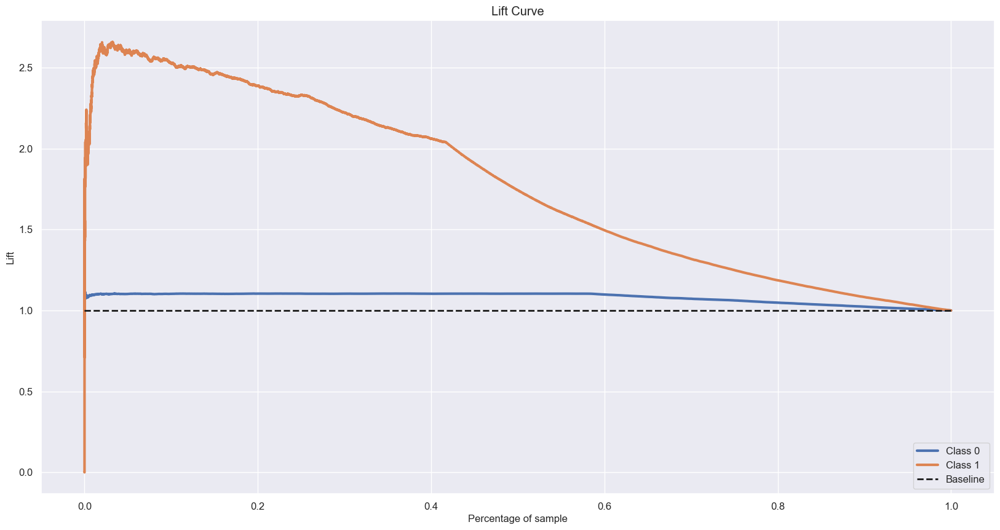

In [158]:
#Scikitplot library is there to help
skplt.metrics.plot_lift_curve( y_val, yhat_knn );

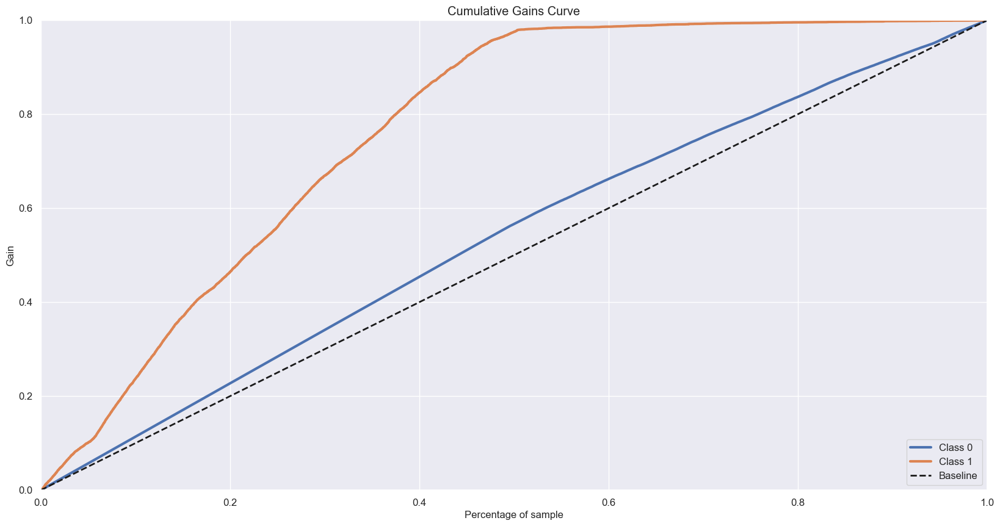

In [159]:
# model definition
lr_model = lm.LogisticRegression( random_state=42 ) 

# model training
lr_model.fit( x_train, y_train )

# model prediction
yhat_lr = lr_model.predict_proba( x_val )

# Accumulative Gain
skplt.metrics.plot_cumulative_gain( y_val, yhat_lr );

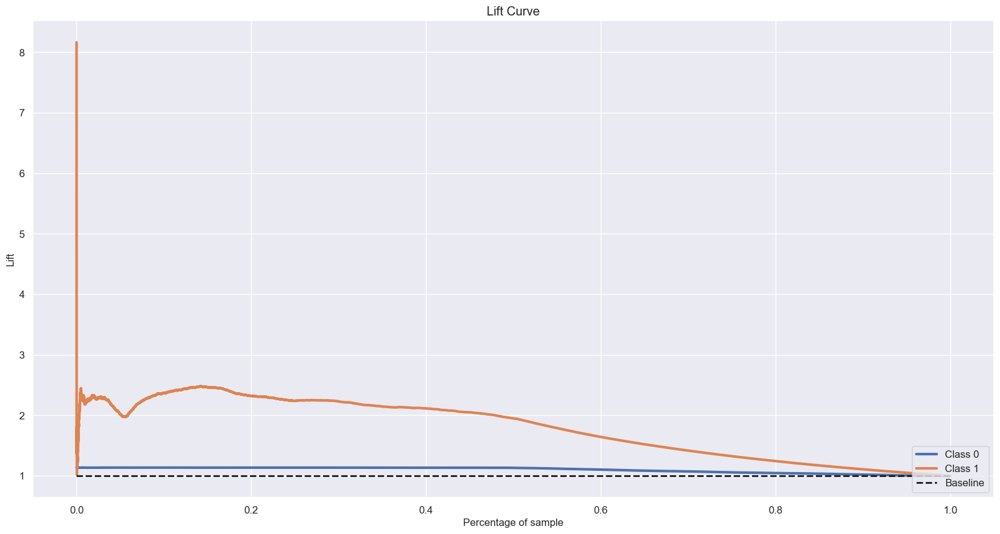

In [160]:
 #Scikitplot library is there to help
skplt.metrics.plot_lift_curve( y_val, yhat_lr );

## 7.4. Extra Trees

In [161]:
# model definition
et = en.ExtraTreesClassifier( n_estimators=1000, n_jobs=-1, random_state=42 )

# model fit
et.fit( x_train, y_train )

# model predict
yhat_et = et.predict_proba( x_val )

In [162]:
# model predict
yhat_et = et.predict_proba( x_val )

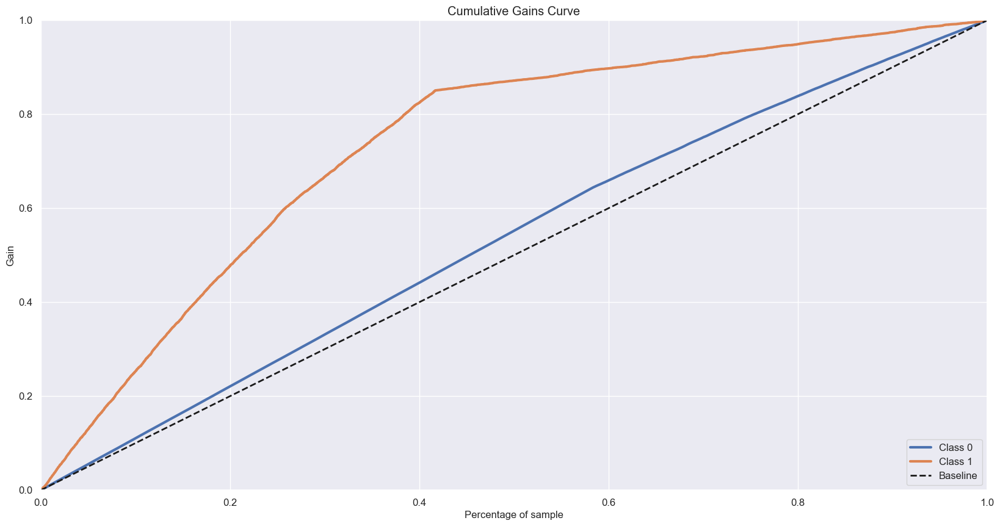

In [163]:
 # Accumulative Gain
skplt.metrics.plot_cumulative_gain( y_val, yhat_knn );

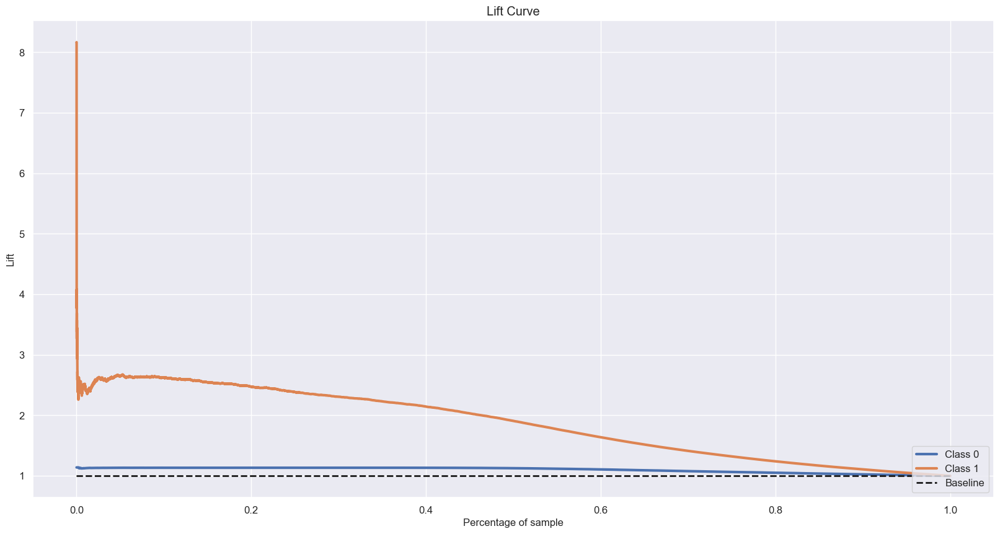

In [164]:
#Scikitplot library is there to help
skplt.metrics.plot_lift_curve( y_val, yhat_et );

## 7.5 Random Forest

In [154]:
# model definition
rf = en.RandomForestClassifier( n_estimators = 1000, n_jobs = -1, random_state = 42)

# model training
rf.fit( x_train, y_train )

# model prediction
yhat_rf = et.predict_proba( x_val )

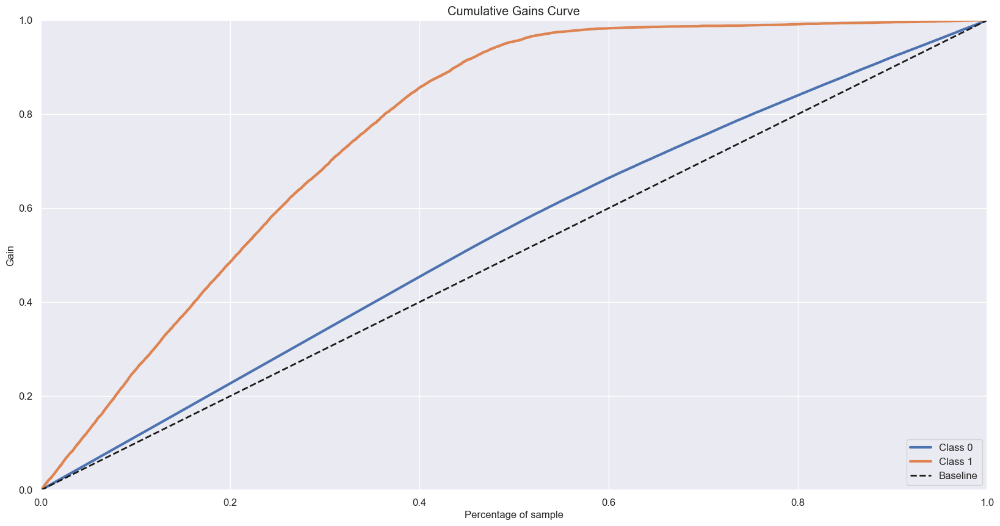

In [155]:
skplt.metrics.plot_cumulative_gain( y_val, yhat_rf );

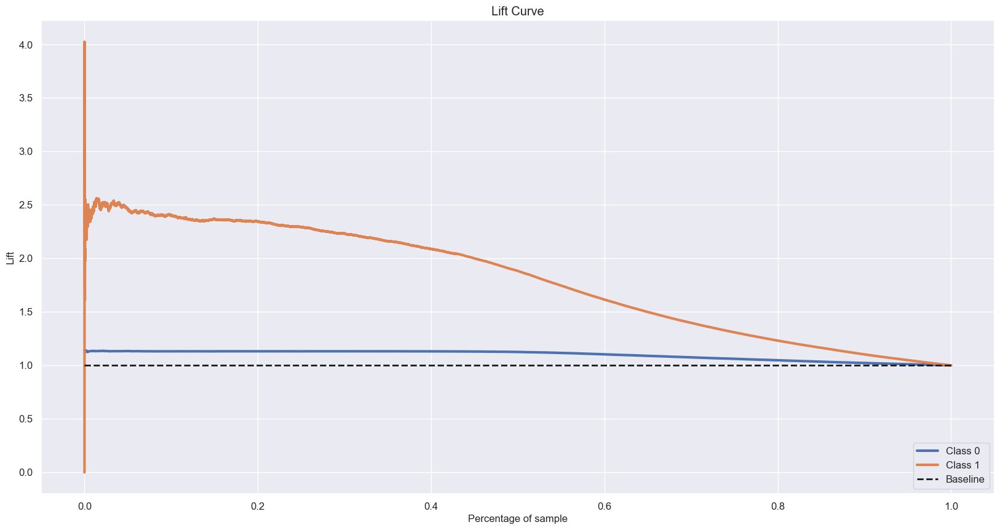

In [102]:
#Scikitplot library is there to help
skplt.metrics.plot_lift_curve( y_val, yhat_rf );

In [116]:
import xgboost           as xgb
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes  import GaussianNB
from sklearn.neighbors    import KNeighborsClassifier
from sklearn              import svm
#from lightgbm             import LGBMClassifier

# 8.0. Model Performance 

In [165]:
df8 = x_validation.copy()
df8['response'] = y_validation.copy()
#df8 = df8[['id' , 'response']]

#Propensity Score
df8['score'] = yhat_knn[:, 0].tolist()

#Sort Clients by Propensity Score
df8 = df8.sort_values('score' , ascending = False)


In [166]:
print(df8.shape[0])
print(df8['response'].sum())

76222
9334


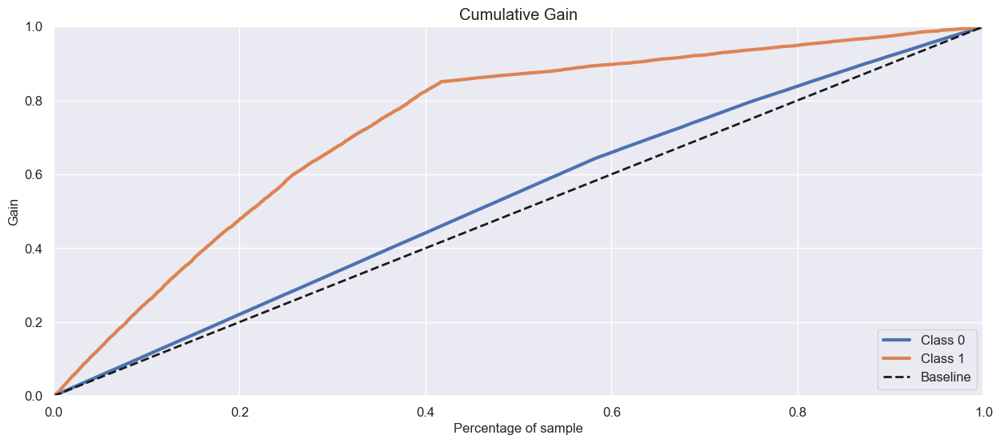

In [167]:
skplt.metrics.plot_cumulative_gain(y_validation, yhat_knn,figsize =(15,6),title='Cumulative Gain');  

In [288]:
#Reset Index
df8 = df8.reset_index( drop = True)


#Create Ranking Order
df8['ranking'] = df8.index + 1

df8['precision_at_k'] = df8['response'].cumsum() / df8['ranking']
df8['recall_at_k'] = df8['response'].cumsum() / df8['response'].sum()

df8[['id' , 'response', 'score','ranking', 'precision_at_k','recall_at_k']]

,id,response,score,ranking,precision_at_k,recall_at_k
0,49064,1,1.000000,1,1.000000,0.000106
1,78127,1,1.000000,2,1.000000,0.000213
2,264895,0,1.000000,3,0.666667,0.000213
3,58381,0,1.000000,4,0.500000,0.000213
4,6262,0,1.000000,5,0.400000,0.000213
5,43904,0,1.000000,6,0.333333,0.000213
6,96800,0,1.000000,7,0.285714,0.000213
7,110250,0,1.000000,8,0.250000,0.000213
8,52624,0,1.000000,9,0.222222,0.000213
9,35848,0,1.000000,10,0.200000,0.000213


In [168]:
def precision_at_k( data, k=2000 ):
 
    # reset index
    data = data.reset_index( drop=True )
    
    # create ranking order
    data['ranking'] = data.index + 1 

    data['precision_at_k'] = data['response'].cumsum() / data['ranking']
    

    return data.loc[k, 'precision_at_k']



In [169]:
def recall_at_k( data, k=2000 ):
    # reset index
    data = data.reset_index( drop=True )

    # create ranking order
    data['ranking'] = data.index + 1 

    data['recall_at_k'] = data['response'].cumsum() / data['response'].sum()

    return data.loc[k, 'recall_at_k']


In [170]:
# copy data
df8 = x_validation.copy()
df8['response'] = y_validation.copy()

# propensity score
df8['score'] = yhat_knn[:, 1].tolist()

# sorte clients by propensity score
df8 = df8.sort_values( 'score', ascending=False )

# compute precision at k
precision_at_50 = precision_at_k( df8, k=51500 )
print( 'Precision at K: {}'.format( precision_at_50 ) ) 

# compute precision at k
precision_at_50 = recall_at_k( df8, k=51500 )
print( 'Recall at K: {}'.format( precision_at_50 )  )


Precision at K: 0.1661521135511932
Recall at K: 0.9167559460038569


## 9.0 Business Performance

In the beginning of this job, the CEO of Insurance All made some questions about model's performance, now I'll respond all of them. 

### 1 - Principais Insights sobre os atributos mais relevantes de clientes interessados em adquirir um seguro de automóvel.
 Customer between 30-50 have more interesting in vehicle Insurance.Customer with newest cars, have more interesting in vehicle Insurance.Customer in in some espefics region have more interesting in vehicle Insurance.
 
 
 The Attributes more relevantes to define customer interesting are (previouslyInsured,annualPremium,vintage,age,regionCode,policySalesChannel,vehicleDamage 
 
 
### 2 - Qual a porcentagem de clientes interessados em adquirir um seguro de automóvel,  o time de vendas conseguirá contatar fazendo 20.000 ligações?###

Made 20.000 calls using the model to ranking the customers, the sale team will call to 60,67% of all interested, about 2.4x more times that random method.



In [171]:
calls=20000
totalLeads=df8.shape[0]
percCalls=calls/totalLeads
print('Insurance All total leads: {}'.format(totalLeads))
print('Insurance All % of calls: {0:.2f}%'.format(percCalls*100))

Insurance All total leads: 76222
Insurance All % of calls: 26.24%


In [172]:
df8 = x_validation.copy()
df8['response'] = y_validation.copy()

# propensity score
df8['score'] = yhat_knn[:, 1].tolist()

# sorte clients by propensity score
df8 = df8.sort_values( 'score', ascending=False )
# compute precision at k
precision_at_50 = precision_at_k( df8, k=20000 )
print( 'Precision at K: {}'.format( precision_at_50 ) ) 

# compute precision at k
precision_at_50 = recall_at_k( df8, k=20000 )
print( 'Recall at K: {}'.format( precision_at_50 )  )


Precision at K: 0.28303584820758965
Recall at K: 0.6064923934004713


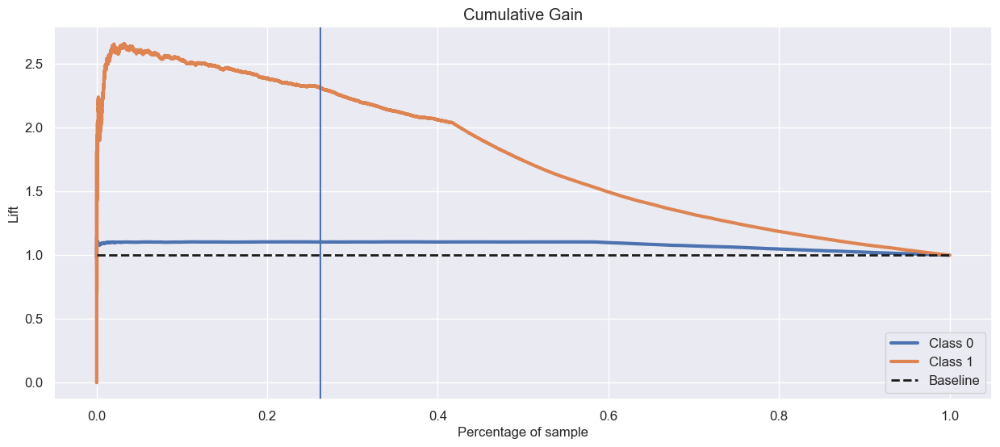

In [173]:
skplt.metrics.plot_lift_curve(y_validation, yhat_knn,figsize =(15,6),title='Cumulative Gain');
plt.axvline(x=0.2624)

### 3 - E se a capacidade do time de vendas aumentar para 40.000 ligações, qual a porcentagem de clientes interessados em adquirir um seguro de automóvel o time de vendas conseguirá contatar?

Made 40.000 calls using the model to ranking the customers, the sale team will call to 88,01% of all interested, about 1.6 more times that random method.

In [174]:
calls=40000
totalLeads=df8.shape[0]
percCalls=calls/totalLeads
print('Insurance All total leads: {}'.format(totalLeads))
print('Insurance All % of calls: {0:.2f}%'.format(percCalls*100))

Insurance All total leads: 76222
Insurance All % of calls: 52.48%


In [175]:
df8 = x_validation.copy()
df8['response'] = y_validation.copy()

# propensity score
df8['score'] = yhat_knn[:, 1].tolist()

# sorte clients by propensity score
df8 = df8.sort_values( 'score', ascending=False )
# compute precision at k
precision_at_40000 = precision_at_k( df8, k=40000 )
print( 'Precision at K: {}'.format( precision_at_40000 ) ) 

# compute precision at k
precision_at_40000 = recall_at_k( df8, k=40000 )
print( 'Recall at K: {}'.format( precision_at_40000 )  )

Precision at K: 0.20496987575310618
Recall at K: 0.8784015427469466


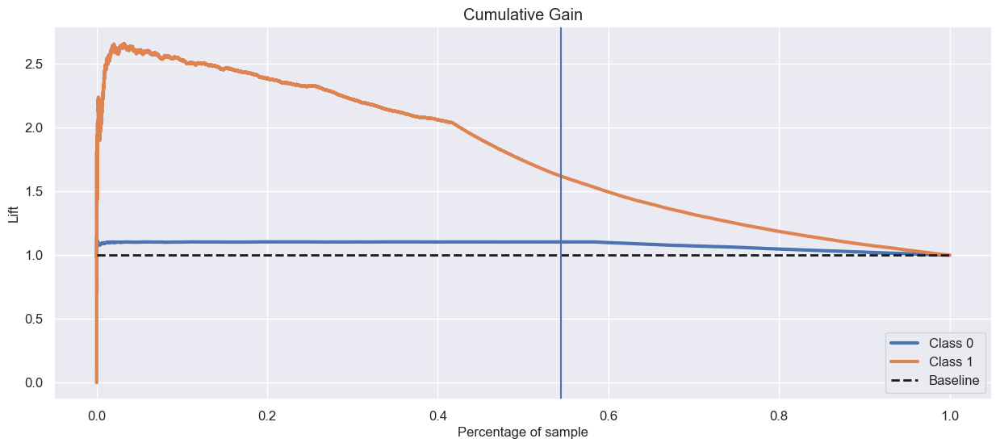

In [176]:
skplt.metrics.plot_lift_curve(y_validation, yhat_knn,figsize =(15,6),title='Cumulative Gain');
plt.axvline(x=0.5448)

## 4 - Quantas ligações o time de vendas precisa fazer para contatar 80% dos clientes interessados em adquirir um seguro de automóvel?

Should be necessary 29077 calls to call to 80% of interesting.

In [177]:
#Reset Index
df8 = df8.reset_index( drop = True)

#Create Ranking Order
df8['ranking'] = df8.index + 1

df8['precision_at_k'] = df8['response'].cumsum() / df8['ranking']
df8['recall_at_k'] = df8['response'].cumsum() / df8['response'].sum()

In [185]:
df8[df8['ranking']==29740]

,id,gender,age,driving_license,region_code,previously_insured,vehicle_damage,annual_premium,policy_sales_channel,vintage,vehicle_age_1-2 Year,vehicle_age_< 1 Year,vehicle_age_> 2 Years,response,score,ranking,precision_at_k,recall_at_k
29739,221816,0.138267,0.523077,1,0.095544,1,1,0.217599,0.208818,0.072664,1,0,0,0,0.142857,29740,0.254136,0.809728


In [186]:
percCalls=29076/len(y_validation)
qtdCalls=int(np.floor(len(x_validation)*percCalls))
print('Should be necessary {} calls to call to 80% of interesting.'.format(qtdCalls))

Should be necessary 29076 calls to call to 80% of interesting.


### Model Result
20,000 calls(15.74%)Suposing that each vehicle Insurance was sell at 2000, the mode bring 298% percent of result totalizing $5,836,494.77.

In [187]:
np.set_printoptions(suppress=True)
pd.set_option('display.float_format', lambda x: '%.4f' % x)

In [188]:
def recall_at_k(df,yhat_proba,target,perc=0.25):
    k=int(np.floor(len(df)*perc))
    df['score']=yhat_proba[:,1].tolist()
    df=df.sort_values('score',ascending=False)
    df=df.reset_index(drop=True)
    df['recall_at_k']=df[target].cumsum()/df[target].sum()
    return df.loc[k,'recall_at_k']

In [189]:
calls=20000
totalLeads=df8.shape[0]
percCalls=calls/totalLeads
print('Insurance All total leads: {}'.format(totalLeads))
print('Insurance All % of calls: {0:.2f}%'.format(percCalls*100))

Insurance All total leads: 76222
Insurance All % of calls: 26.24%


In [190]:
df_mp = x_validation.copy()
customerInteresting=pd.DataFrame()
df_mp['response']=y_validation
probas=[yhat_knn]


customerInteresting=topK_performance(df_mp,probas,'response',[percCalls])
customerInteresting['R$ model']=customerInteresting['target_at_k']*2000
customerInteresting['target_random']=customerInteresting['perc']*customerInteresting['target_total']
customerInteresting['R$ random']=customerInteresting['target_random']*2000
customerInteresting['R$ Final']=customerInteresting['R$ model']-customerInteresting['R$ random']
customerInteresting['% Final']=customerInteresting['R$ model']/customerInteresting['R$ random']
customerInteresting

TypeError: precision_at_k() takes from 1 to 2 positional arguments but 4 were given

In [349]:
x_validation.head()

,id,gender,age,region_code,annual_premium,policy_sales_channel,vintage,vehicle_age_1-2 Year,vehicle_age_< 1 Year,vehicle_age_> 2 Years,driving_license_0,driving_license_1,previously_insured_0,previously_insured_1,vehicle_damage_0,vehicle_damage_1
205805,205806,0.103854,0.015385,0.062216,-0.191073,0.354180,0.968858,0,1,0,0,1,0,1,1,0
338377,338378,0.138100,0.800000,0.130289,-0.127188,0.208267,0.698962,1,0,0,0,1,1,0,0,1
128314,128315,0.138100,0.153846,0.072727,-1.624347,0.208267,0.955017,1,0,0,0,1,1,0,0,1
62708,62709,0.138100,0.615385,0.100920,-0.397040,0.000321,0.536332,1,0,0,0,1,1,0,0,1
222617,222618,0.103854,0.723077,0.186548,0.970371,0.208267,0.653979,1,0,0,0,1,0,1,1,0


In [216]:
import requests

In [217]:
# loading test dataset
df_test = x_validation
df_test['response'] = y_validation

In [218]:
df_test = df_test.sample(10) 

In [219]:
df_test

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage,response
308774,308775,Male,72,1,46.0000,0,1-2 Year,0,44230.0000,26.0000,142,0
165163,165164,Female,22,1,14.0000,1,< 1 Year,0,21810.0000,152.0000,296,0
4956,4957,Male,68,1,8.0000,1,1-2 Year,0,52240.0000,26.0000,159,0
291817,291818,Female,39,1,28.0000,0,1-2 Year,1,45564.0000,124.0000,276,0
236502,236503,Female,23,1,3.0000,1,< 1 Year,0,29604.0000,152.0000,261,0
19560,19561,Female,27,1,33.0000,1,< 1 Year,0,28215.0000,152.0000,243,0
161814,161815,Male,23,1,8.0000,1,< 1 Year,0,59287.0000,26.0000,106,0
172719,172720,Male,21,1,33.0000,1,< 1 Year,0,32761.0000,152.0000,34,0
348513,348514,Male,24,1,45.0000,1,< 1 Year,0,20135.0000,160.0000,119,0
321495,321496,Male,22,1,33.0000,1,< 1 Year,0,26968.0000,152.0000,111,0


In [220]:
# convert dataframe to json
data = json.dumps( df_test.to_dict( orient='records' ) )

In [221]:
data

'[{"id": 308775, "gender": "Male", "age": 72, "driving_license": 1, "region_code": 46.0, "previously_insured": 0, "vehicle_age": "1-2 Year", "vehicle_damage": 0, "annual_premium": 44230.0, "policy_sales_channel": 26.0, "vintage": 142, "response": 0}, {"id": 165164, "gender": "Female", "age": 22, "driving_license": 1, "region_code": 14.0, "previously_insured": 1, "vehicle_age": "< 1 Year", "vehicle_damage": 0, "annual_premium": 21810.0, "policy_sales_channel": 152.0, "vintage": 296, "response": 0}, {"id": 4957, "gender": "Male", "age": 68, "driving_license": 1, "region_code": 8.0, "previously_insured": 1, "vehicle_age": "1-2 Year", "vehicle_damage": 0, "annual_premium": 52240.0, "policy_sales_channel": 26.0, "vintage": 159, "response": 0}, {"id": 291818, "gender": "Female", "age": 39, "driving_license": 1, "region_code": 28.0, "previously_insured": 0, "vehicle_age": "1-2 Year", "vehicle_damage": 1, "annual_premium": 45564.0, "policy_sales_channel": 124.0, "vintage": 276, "response": 0},

In [227]:
# API Call
url = 'http://0.0.0.0:5000/heathinsurance/predict'
#url = 'https://health-insurance-model.herokuapp.com/predict'
header = {'Content-type': 'application/json' }

r = requests.post( url, data=data, headers=header )
print( 'Status Code {}'.format( r.status_code ) )

Status Code 500


In [75]:
d1 = pd.DataFrame( r.json(), columns=r.json()[0].keys() )
d1.sort_values( 'score', ascending=False ).head()

JSONDecodeError: Expecting value: line 1 column 1 (char 0)

In [192]:
import pickle

In [193]:
#Save Model
pickle.dump( knn_model, open( '/Users/jefersonlima/GitHub/pa004_health_insurance_cross_sell/src/models/knn_model_regression.pkl', 'wb' ) )